In [2]:
import numpy as np 
import matplotlib.pyplot as plt
import matplotlib
matplotlib.rcParams['figure.dpi'] = 200
import pandas as pd
from tifffile import imsave
from a72_utilities import *
import os
from sklearn.decomposition import PCA, NMF
from sklearn.preprocessing import MinMaxScaler, StandardScaler
from skimage.measure import shannon_entropy
from sklearn.feature_selection  import mutual_info_regression
from sklearn.cluster import KMeans
from sklearn.metrics import silhouette_score, silhouette_samples
from sklearn.model_selection import train_test_split

In [3]:
def get_img_data_folder(folder_path:str):
    """
    Extracts a series .tif formatted images from the specified folder
    and stores the results in a Pandas DataFrame with custom column names.

    The function scans all '.tif' files in the provided folder. For each file, it reads the data,
    flattens it into a 1D array, and associates it with descriptor label from the filename. The 
    data is stored as a column in the resulting DataFrame, with the descriptors serving as column labels.

    Args:
        folder_path (str): The path to the folder containing the .tif files to process.

    Returns:
        pd.DataFrame: A Pandas DataFrame with each column representing the data from 
                      each .tif text file, labeled with the correspondin scan type as the column name.

    Notes:
        - Assumes that the filename contains the descriptor.

    Example:
        folder_path = '/path/to/your/folder'
        df = get_TOFSIMS_data(folder_path)
        print(df)
    """
    columns = {}
    for filename in os.listdir(folder_path):
        # Check if the file is a .tif file

        if filename.endswith('.tif'):
            file_path = os.path.join(folder_path, filename)
            series = imread(file_path).flatten()
            try:
                descriptor = filename.split("- ")[1]
                descriptor = descriptor.split('.')[0]
            except:
                descriptor = filename

            if series.size > 0:
                columns[descriptor] = series
    return pd.DataFrame(columns)

In [4]:
test_dir = '/Users/apple/Sync/Research/Alloy 72/A72 Tof SIMS/Registered components'
preprocessing_data = get_img_data_folder(test_dir)
# print(preprocessing_data.head)
# print(preprocessing_data.shape[0])

imsize = int(np.sqrt(preprocessing_data.shape[0]))
print(imsize)
xx, xy = np.meshgrid(range(imsize), range(imsize))

X = np.array((xx.flatten(),xy.flatten())).T

mic = []
snr = []
for column in preprocessing_data:
    print(X.shape, preprocessing_data[column].shape, type(preprocessing_data[column]))

    xtrain, xtest, ytrain, ytest = train_test_split(pd.DataFrame(X), preprocessing_data[column], test_size=0.8, random_state=42)
    print(xtrain.shape,ytrain.shape,xtest.shape,ytest.shape)
    mic.append(mutual_info_regression(xtrain, ytrain))
    snr.append(np.mean(ytest) / np.std(ytest))



487
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (189736,)
(237169, 2) (237169,) <class 'pandas.core.series.Series'>
(47433, 2) (47433,) (189736, 2) (18973

Text(0, 0.5, 'Mutual Information Coefficient')

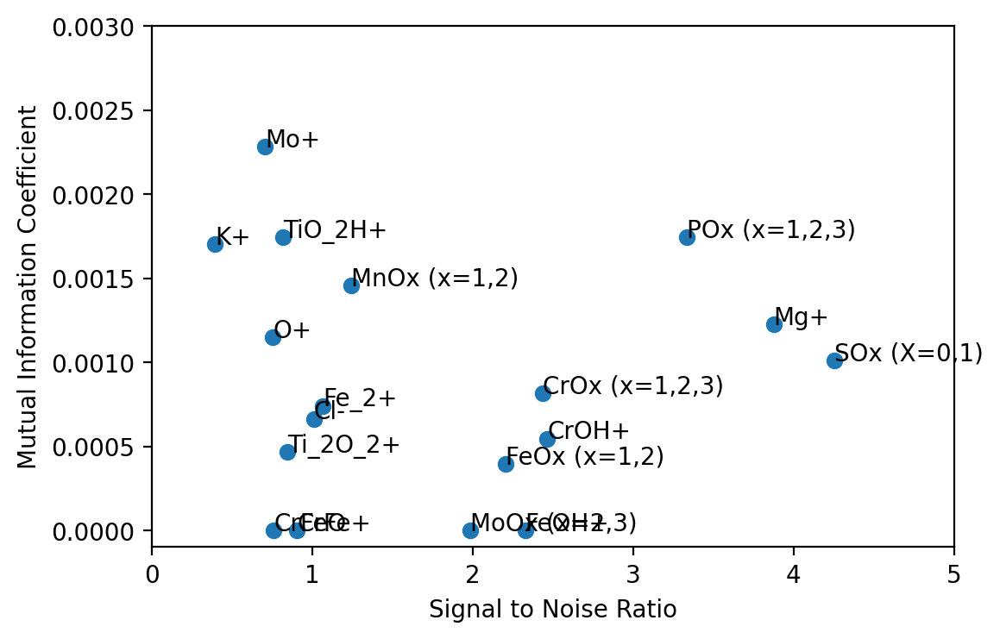

In [5]:

fig, ax = plt.subplots()
ax.scatter(snr,np.average(mic,axis=1))


ax.set_xbound((0,5))
ax.set_ybound((-.0001,.003))

for i, label in enumerate(preprocessing_data.columns):
    if snr[i] < 5 and np.average(mic,axis=1)[i] < .003:
        ax.annotate(label, (snr[i], np.average(mic,axis=1)[i]))

plt.xlabel("Signal to Noise Ratio")
plt.ylabel("Mutual Information Coefficient")


In [6]:
data_dir = '/Users/apple/Sync/Research/Alloy 72/A72 Tof SIMS/Registered components/Registered metals only'
registered_data = get_img_data_folder(data_dir)
registered_data.head()

,Fe+,Ni+,Mn+,CrFe+,"AlOx (x=1,2)",O+,"FeOx (x=1,2)",TiO_2H+,Ti+,"Ox (x=1,2)",...,TiO_2,CrOH+,FeOH+,CrFeO,Al+,Cr+,"NiOx (x=1,2)","MoOx (x=2,3)",Fe_2+,TiO+
0,111,3,44,0,25,0,8,0,51,184,...,0,8,9,0,100,101,0,5,0,17
1,97,10,43,2,20,0,7,0,56,188,...,1,8,8,1,100,105,0,5,2,16
2,101,9,39,3,38,1,8,0,49,175,...,1,6,5,0,102,107,1,5,1,18
3,98,7,28,1,30,0,6,0,46,192,...,2,8,9,1,109,114,1,8,1,19
4,94,14,44,0,28,0,7,0,45,186,...,0,10,2,1,105,111,2,3,1,16


In [7]:
registered_data.describe()
# feoh_FeOX_frac = registered_data["FeOH+"]/(registered_data["FeOH+"] + registered_data["FeOx (x=1,2)"])
# al_ti_frac = registered_data["Al+"]/(registered_data["Al+"] + registered_data["Ti+"])
# plt.hist(feoh_FeOX_frac, bins=100)
# plt.show()
# plt.hist(al_ti_frac, bins=100)
# plt.show()
# plt.hist(registered_data["FeOx (x=1,2)"]/(registered_data["MoOx (x=2,3)"]+registered_data["FeOx (x=1,2)"]), bins=100)
# plt.show()

,Fe+,Ni+,Mn+,CrFe+,"AlOx (x=1,2)",O+,"FeOx (x=1,2)",TiO_2H+,Ti+,"Ox (x=1,2)",...,TiO_2,CrOH+,FeOH+,CrFeO,Al+,Cr+,"NiOx (x=1,2)","MoOx (x=2,3)",Fe_2+,TiO+
count,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,...,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000,237169.000000
mean,92.895130,8.042219,43.668667,0.841307,29.952840,0.575788,5.813458,0.723307,56.015799,187.485536,...,0.316420,7.266089,5.692384,0.587497,111.663704,104.669451,0.603979,4.730070,1.174833,19.578499
std,10.904992,3.213265,6.602069,0.928257,7.181834,0.759356,2.636763,0.881930,18.599360,10.825084,...,0.571091,2.946279,2.445583,0.770880,19.159776,17.624869,0.807749,2.384584,1.098831,10.377685
min,12.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,8.000000,77.000000,...,0.000000,0.000000,0.000000,0.000000,11.000000,2.000000,0.000000,0.000000,0.000000,1.000000
25%,88.000000,6.000000,40.000000,0.000000,25.000000,0.000000,4.000000,0.000000,47.000000,182.000000,...,0.000000,5.000000,4.000000,0.000000,102.000000,102.000000,0.000000,3.000000,0.000000,14.000000
50%,94.000000,8.000000,44.000000,1.000000,29.000000,0.000000,6.000000,1.000000,52.000000,188.000000,...,0.000000,7.000000,6.000000,0.000000,108.000000,108.000000,0.000000,5.000000,1.000000,17.000000
75%,100.000000,10.000000,48.000000,1.000000,33.000000,1.000000,7.000000,1.000000,57.000000,194.000000,...,1.000000,9.000000,7.000000,1.000000,114.000000,114.000000,1.000000,6.000000,2.000000,21.000000
max,132.000000,32.000000,71.000000,8.000000,77.000000,7.000000,20.000000,13.000000,200.000000,237.000000,...,7.000000,22.000000,20.000000,6.000000,208.000000,145.000000,7.000000,17.000000,9.000000,138.000000


(-0.5, 486.5, 486.5, -0.5)

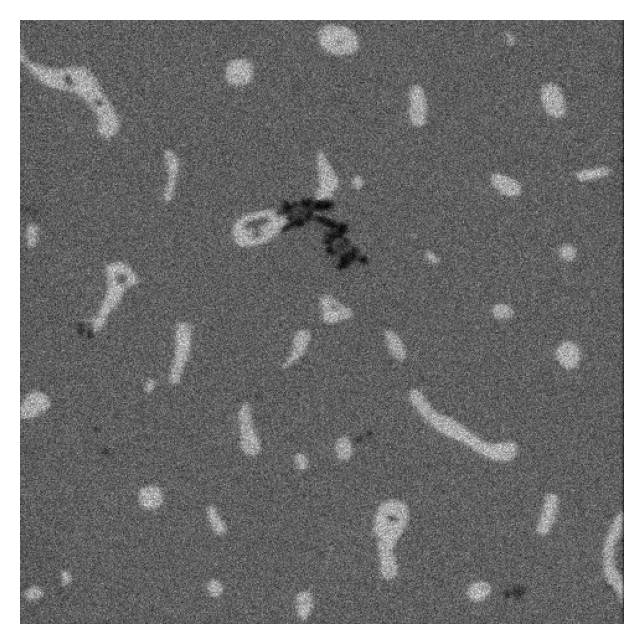

In [8]:
plt.imshow(registered_data['AlOx (x=1,2)'].to_numpy().reshape(imsize,imsize), cmap='gray')
plt.axis('off')

In [9]:
minmax_scaler = MinMaxScaler()
standard_scaler = StandardScaler()
pca = PCA()
#pca=NMF(n_components=5,max_iter=1000)
minmax_normalized = minmax_scaler.fit_transform(registered_data)
standard_normalized = standard_scaler.fit_transform(registered_data)
# fit_pca = pca.fit(minmax_normalized)
# pca_scores = pca.fit_transform(minmax_normalized)
fit_pca = pca.fit(standard_normalized)
pca_scores = pca.fit_transform(standard_normalized)
# fit_pca = pca.fit(registered_data)
# pca_scores = pca.fit_transform(registered_data)
imsize = int(np.sqrt(len(pca_scores[:,0])))

17


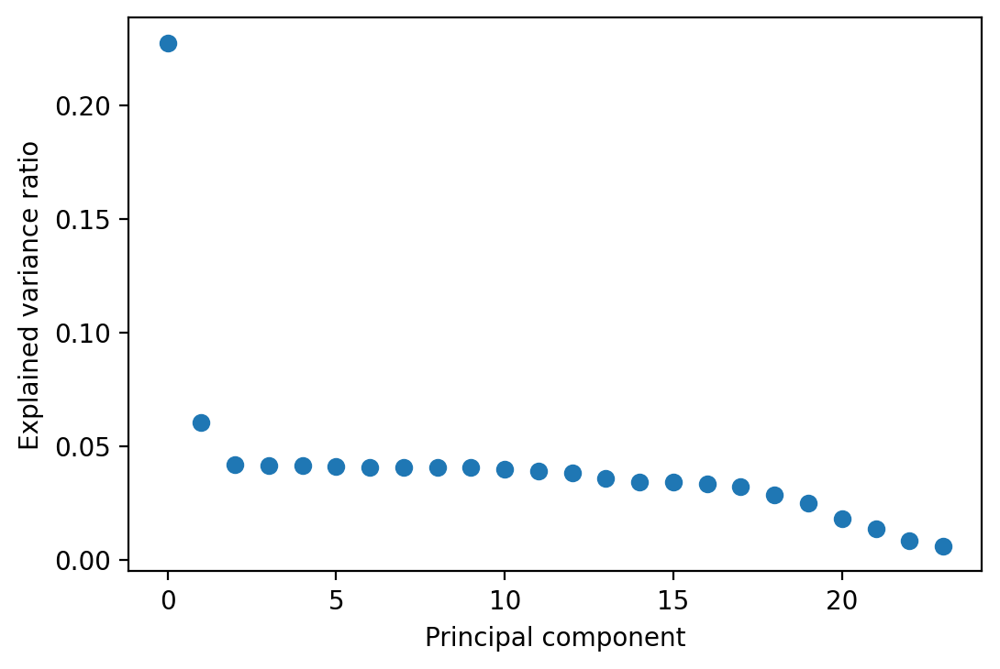

In [10]:
#Plot the explained variance 

#Cumulative variance
#plt.scatter(range(len(fit_pca.explained_variance_ratio_)),np.cumsum(fit_pca.explained_variance_ratio_))
#Individual variance
plt.scatter(range(len(fit_pca.explained_variance_ratio_)),(fit_pca.explained_variance_ratio_))

plt.ylabel("Explained variance ratio")
plt.xlabel("Principal component")
threshold = np.where(np.cumsum(fit_pca.explained_variance_ratio_) > 0.90)[0][0]
print(threshold)
#plt.plot([0,30],[0.90,0.90])
plt.show()


In [11]:
#plt.imshow(np.sum(pca_scores.T[:15].reshape(15,imsize,imsize),axis=0), cmap='gray')

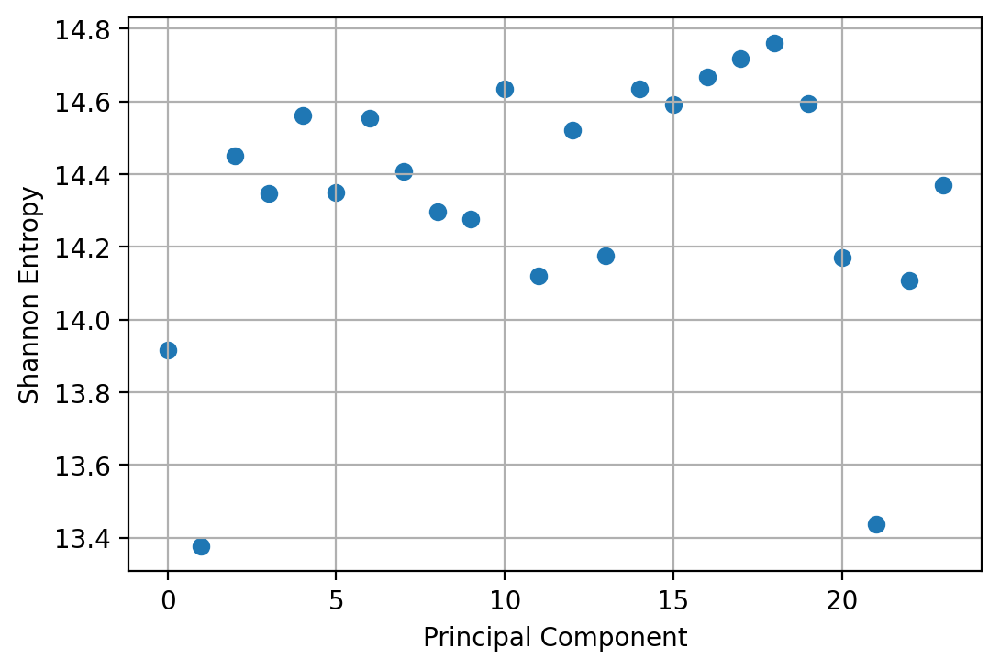

In [12]:
#plot the entropies of the components 
entropies = []
for component in pca_scores.T:
    entropies.append(shannon_entropy(make_16bit(component.reshape(imsize,imsize))))
plt.scatter(range(len(entropies)), entropies)
plt.grid(visible=True)
plt.ylabel("Shannon Entropy")
plt.xlabel("Principal Component")
plt.show()



In [13]:
#Tried using maximum information coefficient to find if the component image has meaningful spatial information, but it's hard to say.
xx, xy = np.meshgrid(range(imsize), range(imsize))

X = np.array((xx.flatten(),xy.flatten())).T
print(X.shape)

mic = []
for component in pca_scores.T:
    mic.append(mutual_info_regression(X, normalize_array(component)))
    # print(np.average(mic))


(237169, 2)


Text(0.5, 1.0, 'Mutual information of the loading image for each PCA component')

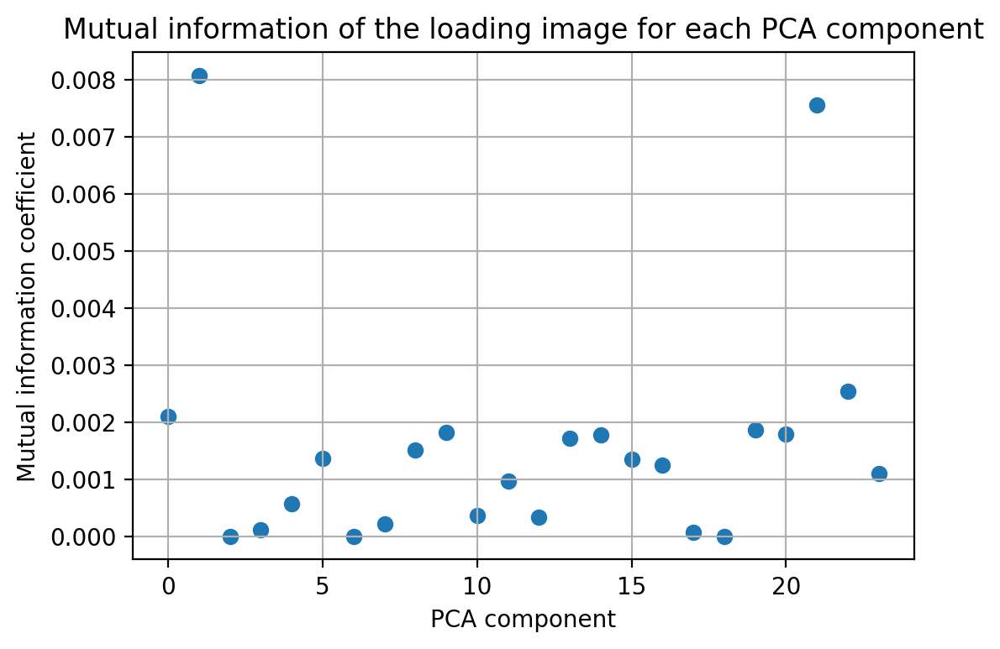

In [14]:
plt.scatter(range(len(mic)), np.average(mic,axis=1))
plt.grid(visible=True)
plt.xlabel("PCA component")
plt.ylabel("Mutual information coefficient")
plt.title("Mutual information of the loading image for each PCA component")

In [15]:
#Try plotting the MIC times the explained variance ratio
#plt.scatter(range(len(mic)),np.average(mic,axis=1)*fit_pca.explained_variance_ratio_)

0.013576424265034364


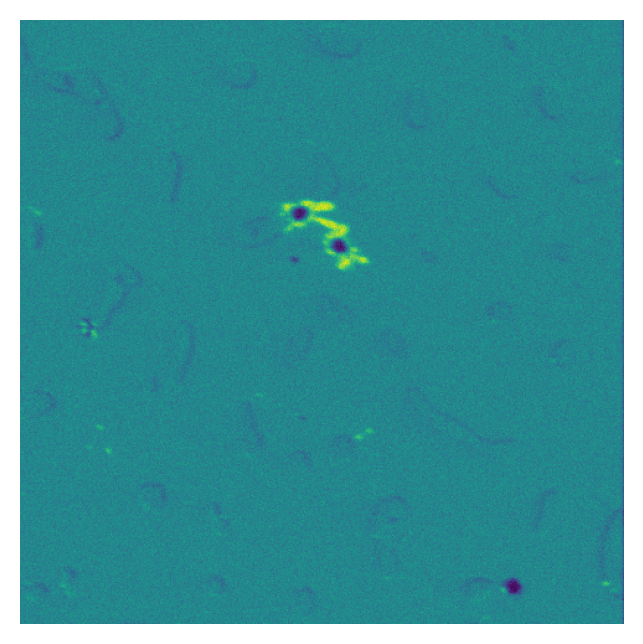

In [16]:
#Plot individual components for figures
pc = 21
plt.imshow(pca_scores.T[pc].reshape(imsize,imsize), cmap='viridis')
plt.axis('off')
print(fit_pca.explained_variance_ratio_[pc])

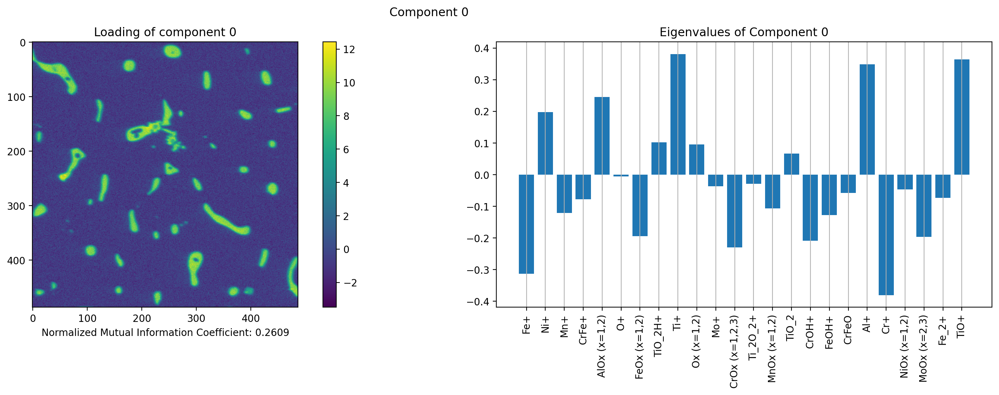

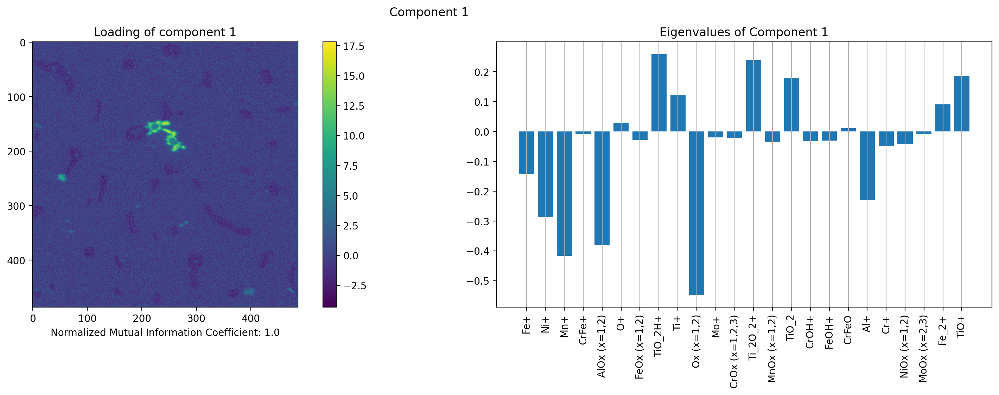

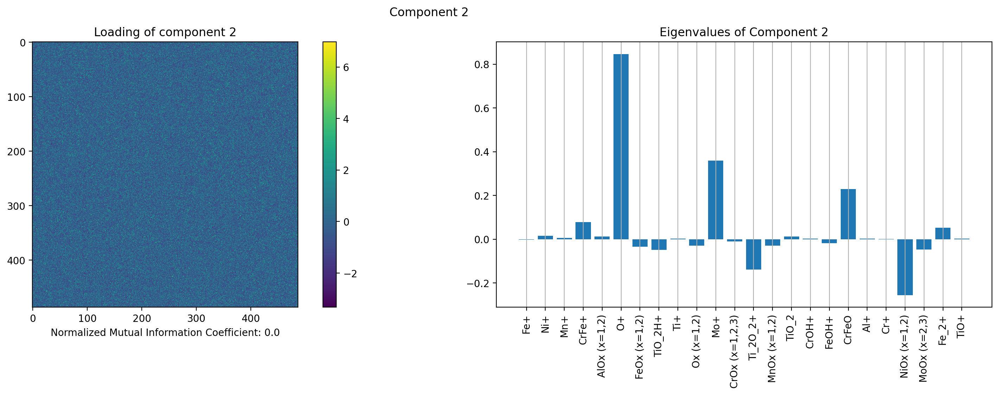

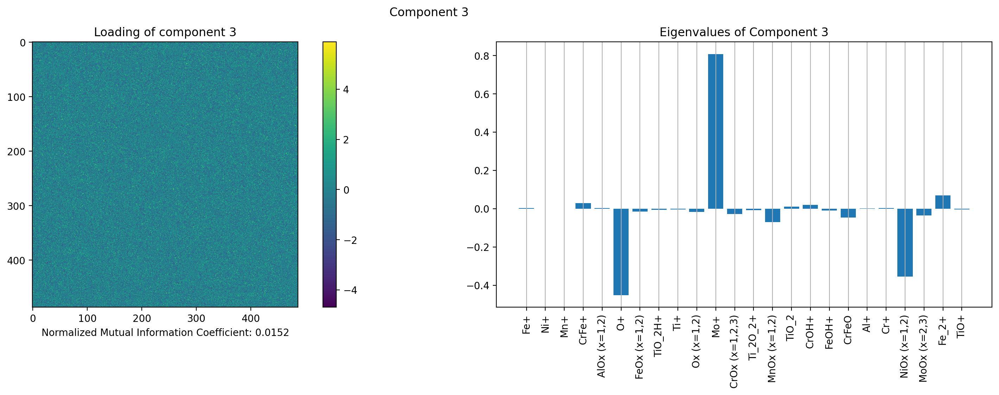

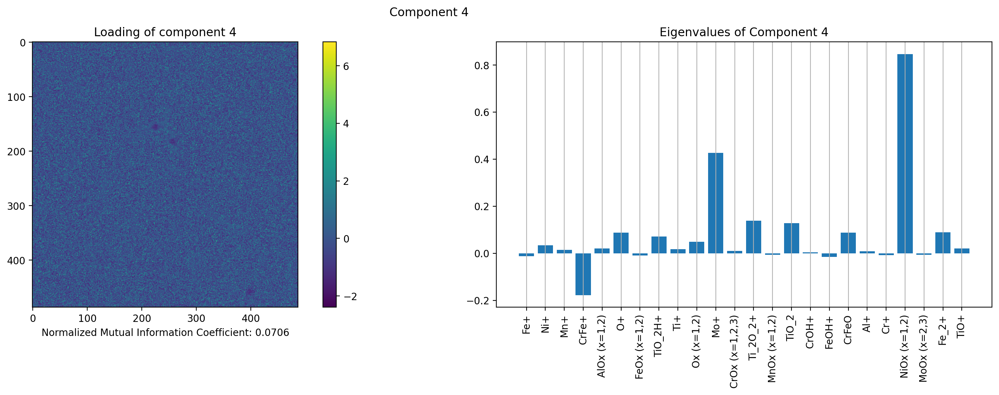

...

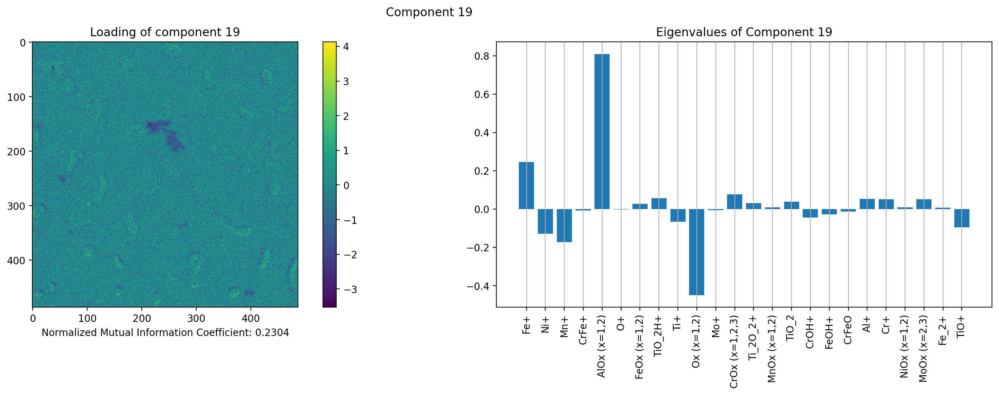

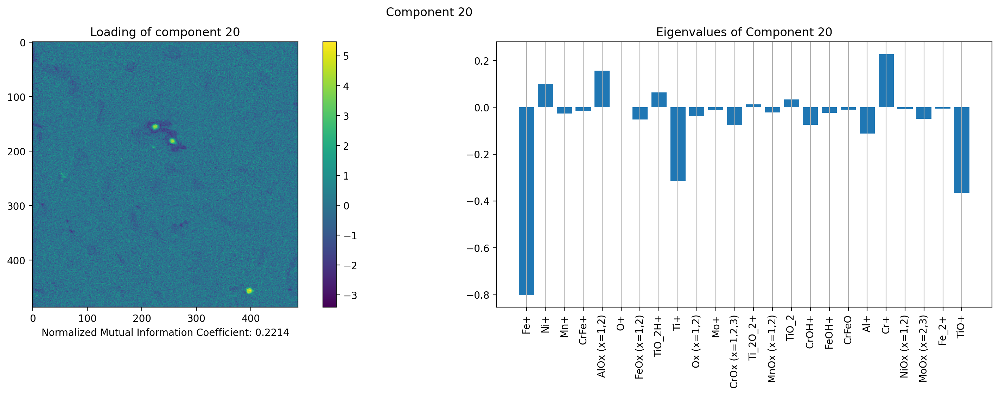

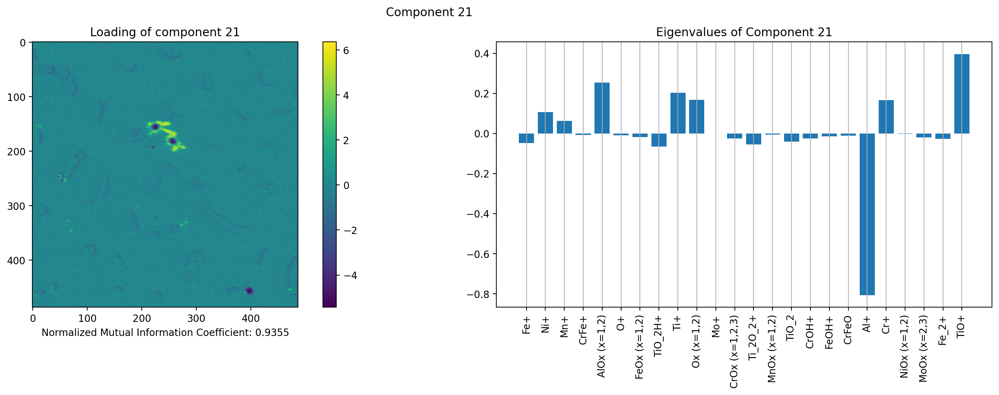

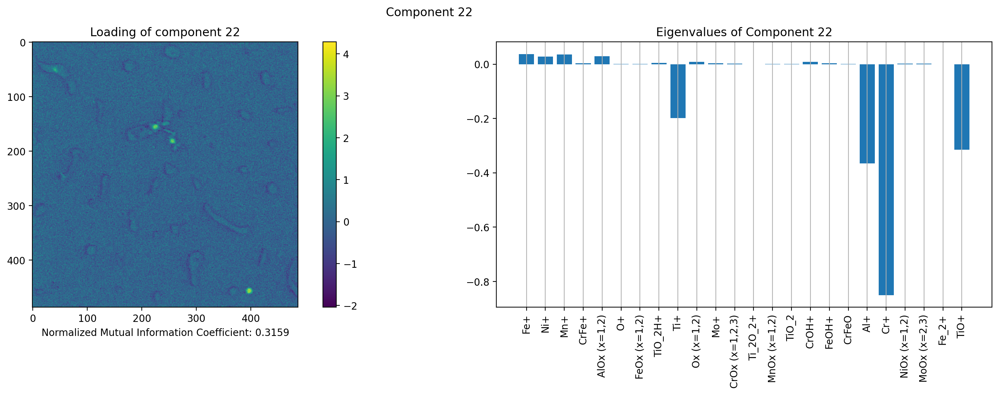

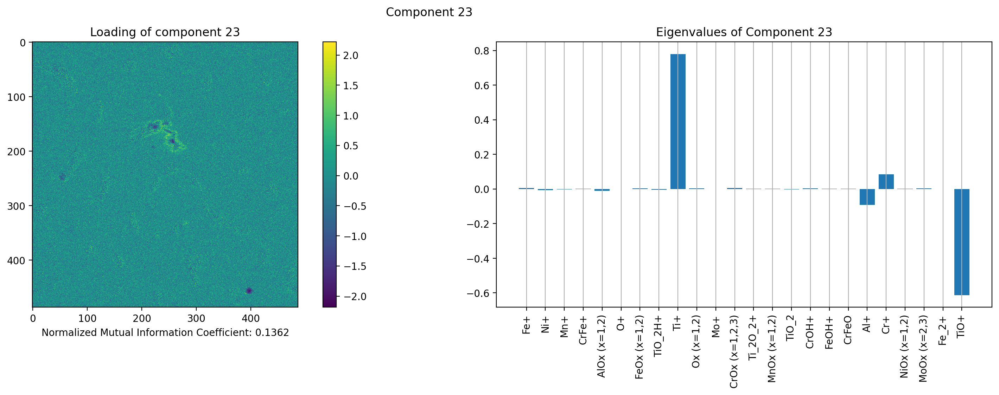

In [17]:

for i, component in enumerate(pca_scores.T):
    fig, ax = plt.subplots(1, 2, figsize=(20,5))
    im = ax[0].imshow(component.reshape(imsize,imsize))
    fig.colorbar(im, ax=ax[0])
    ax[0].set_xlabel("Normalized Mutual Information Coefficient: "+str(np.round(np.average(mic[i]/np.max(np.average(mic,axis=1))),decimals = 4)))
    ax[0].title.set_text("Loading of component "+str(i))

    ax[1].bar(registered_data.columns,fit_pca.components_[i,:])
    plt.xticks(rotation='vertical')
    ax[1].grid(visible=True,axis='x')
    ax[1].title.set_text("Eigenvalues of Component "+str(i))
    fig.suptitle("Component "+str(i))

    component_img = make_16bit(component.reshape(imsize,imsize))
    #imsave('/Users/apple/Sync/Research/Alloy 72/A72 Tof SIMS/Clustering results/PCA/component_'+str(i)+'.tif',component_img)
    plt.show()



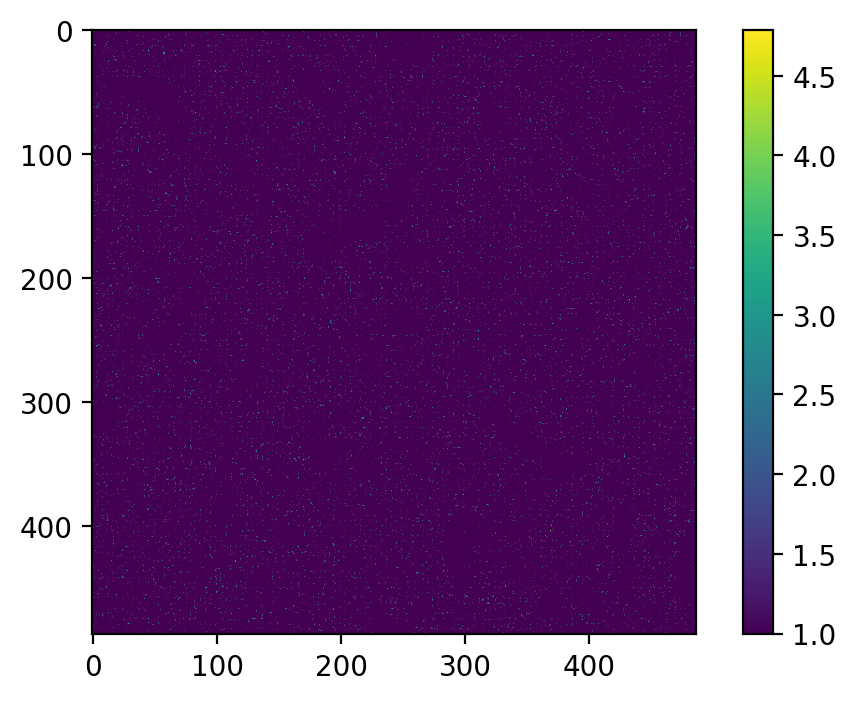

In [18]:
plt.imshow(pca_scores.T[14].reshape(imsize,imsize),vmin=1,cmap='viridis')
plt.colorbar()

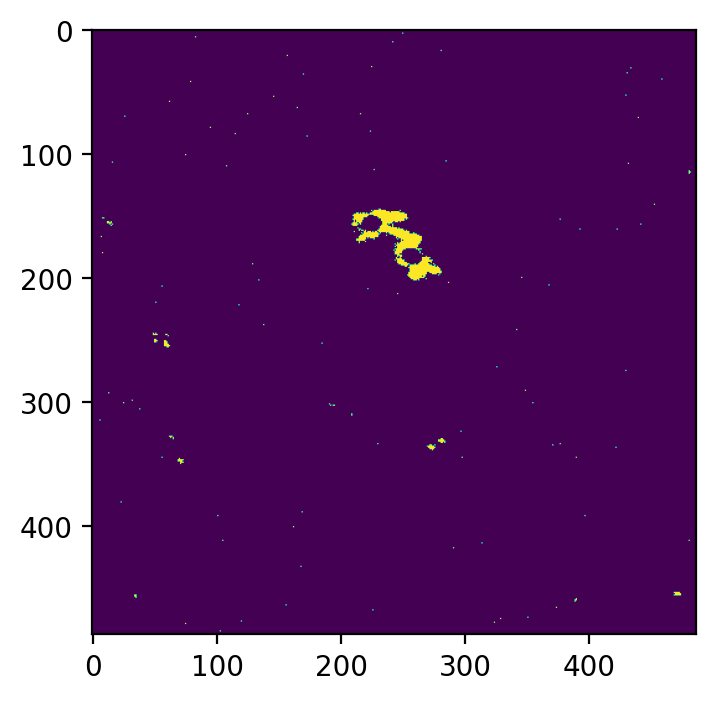

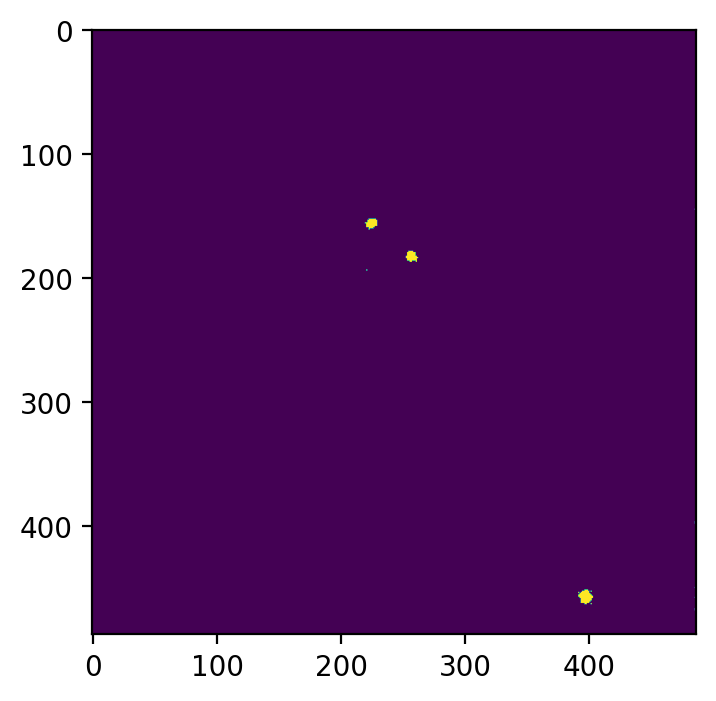

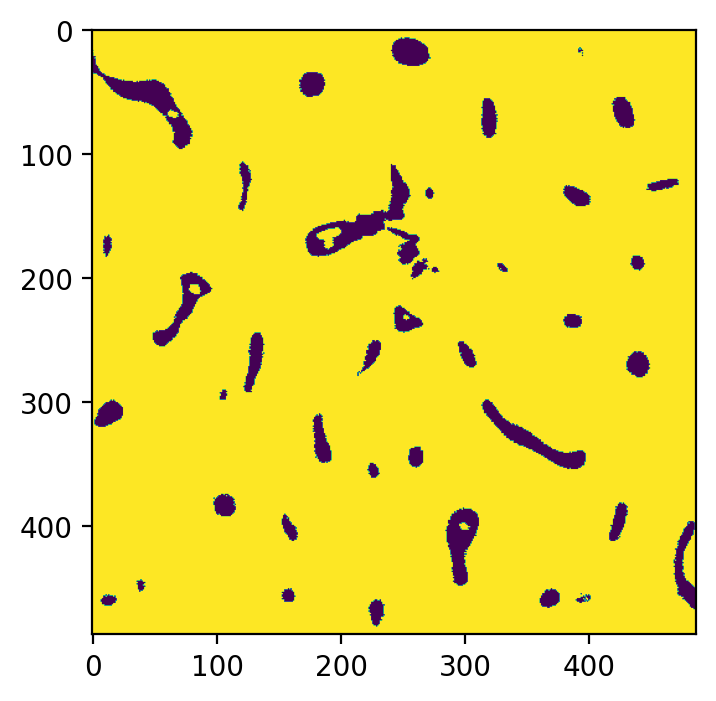

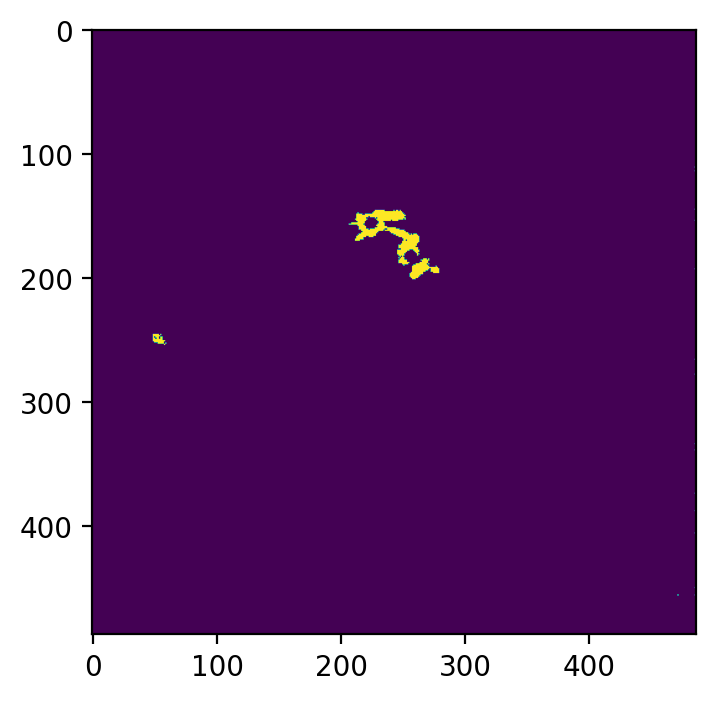

In [29]:
#Create masks segmenting the different phase regions using thresholding of the principal components
ti_mask = pca_scores[:,21].reshape(imsize,imsize)
ti_mask = np.where(ti_mask > 1.6, 1, 0)
plt.imshow(ti_mask)
plt.show()

pc_21 = pca_scores[:,21].reshape(imsize,imsize)
pc_21_mask = np.where(pc_21 < -3, 1, 0)
plt.imshow(pc_21_mask)
plt.show()
pc_0 = pca_scores[:,0].reshape(imsize,imsize)
pc_0_mask = np.where(pc_0 > 6,0,1)
plt.imshow(pc_0_mask)
plt.show()
pc_1 = pca_scores[:,1].reshape(imsize,imsize)
pc_1_mask = np.where(pc_1 > 7,1,0)
plt.imshow(pc_1_mask)
plt.show()


# l21_mask = np.where((pc_1_mask+pc_21_mask+pc_0_mask) == 0, 1, 0)
# plt.imshow(l21_mask)
# pca_masks = [pc_21_mask, pc_0_mask,pc_1_mask,l21_mask]
imsave('/Users/apple/Sync/Research/Alloy 72/A72 Tof SIMS/Masks/Registered masks/ti_mask.tif',ti_mask.astype(np.uint8))
# imsave('/Users/apple/Sync/Research/Alloy 72/A72 Tof SIMS/Masks/Registered masks/pc_21_mask.tif',pc_21_mask.astype(np.uint8))
# imsave('/Users/apple/Sync/Research/Alloy 72/A72 Tof SIMS/Masks/Registered masks/fcc_mask.tif',pc_0_mask.astype(np.uint8))
# imsave('/Users/apple/Sync/Research/Alloy 72/A72 Tof SIMS/Masks/Registered masks/pc_1_mask.tif',pc_1_mask.astype(np.uint8))
# imsave('/Users/apple/Sync/Research/Alloy 72/A72 Tof SIMS/Masks/Registered masks/l21_mask.tif',l21_mask.astype(np.uint8))

In [ ]:
#cluster kmeans using  the transformed PCA data
for i in range(8):
    kmeans = KMeans(n_clusters=i+2)
    kmeans.fit_transform(pca_scores)
    fig, axs = plt.subplots(1,i+2,figsize=((i+2)*5,5))
    for j in range(i+2):
        axs[j].imshow(np.where(kmeans.labels_ == j, 0, 1).reshape(imsize,imsize),cmap='Greys')
    plt.show()

In [ ]:
#Perform K-means directly on the normalized TOF-SIMS data
for i in range(8):
    kmeans = KMeans(n_clusters=i+2, random_state = 1, init='k-means++')
    kmeans.fit_transform(standard_normalized)

    fig, axs = plt.subplots(1,i+2,figsize=((i+2)*5,5))
    for j in range(i+2):
        axs[j].imshow(np.where(kmeans.labels_ == j, 1, 0).reshape(imsize,imsize),cmap='gray')
    plt.show()


In [ ]:
#Perform kmeans clustering directly on the un-normalized TOF-SIMS data
metrics = []
for i in range(6):
    kmeans = KMeans(n_clusters=i+2,init='k-means++',random_state=1)
    kmeans.fit_transform(registered_data)
    cluster_labels = kmeans.predict(registered_data)
    print(i)
    sample_silhouette_values = silhouette_samples(registered_data, cluster_labels)
    metrics.append(np.average(sample_silhouette_values))

    fig, axs = plt.subplots(1,i+2,figsize=((i+2)*5,5))
    for j in range(i+2):
        label_silhouette = np.average(sample_silhouette_values[cluster_labels == j])
        axs[j].imshow(np.where(kmeans.labels_ == j, 1, 0).reshape(imsize,imsize),cmap='gray')
        axs[j].title.set_text("Silhouette: "+str(label_silhouette))
        
    plt.show()
plt.scatter(range(2,10),metrics)
plt.show()

plt.scatter(np.array(range(len(metrics)))+2,metrics)
plt.title("Quality of K-means clustering")
plt.xlabel("Number of clusters in K-means")
plt.ylabel("Average silhouette score")
plt.show()

In [ ]:
n_clusters = 4
optimized_kmeans = KMeans(n_clusters = n_clusters,init='k-means++',random_state = 10)
optimized_kmeans.fit_transform(registered_data)
optimized_cluster_labels = optimized_kmeans.predict(registered_data)

In [ ]:
#display average counts for each cluster
for i in range(n_clusters):
    cluster = np.where(optimized_kmeans.labels_ == i, 1, 0).reshape(imsize,imsize)
    fig, axs = plt.subplots(1,2,figsize=(10,5))
    axs[0].imshow(cluster*100,cmap='gray')
    axs[0].title.set_text("Cluster "+str(i))

    # print(registered_data[optimized_cluster_labels == i].shape)
    # print(np.where(optimized_kmeans.labels_ == i, 0, 1).shape)

    #Normalize the counts per image
    #axs[1].bar(registered_data.columns, np.average((registered_data[optimized_cluster_labels == i]-np.min(registered_data,axis=0))/(np.max(registered_data,axis=0)-np.min(registered_data,axis=0)),axis=0))
    axs[1].bar(registered_data.columns, np.average(registered_data[optimized_cluster_labels == i],axis=0))
    #axs[1].bar(registered_data.columns,np.std(registered_data[optimized_cluster_labels == i],axis=0))

    plt.xticks(rotation='vertical')
    axs[1].grid(visible=True,axis='x')
    axs[1].title.set_text("Cluster Center "+str(i))



In [ ]:
plt.imshow(optimized_cluster_labels.reshape(imsize,imsize),cmap='gist_earth',vmin=0,vmax=4)
plt.axis('off')


In [ ]:

labels = ["FCC","L21",'Edges',"Ti phase"]
colors = ["xkcd:black","xkcd:ocean blue","xkcd:green",'xkcd:beige']
# Get the number of features in your dataset (columns of registered_data)
registered_data.sort_index(axis=1, inplace=True)
n_features = len(registered_data.columns)

# Set up the positions of the bars
bar_width = 0.2  # Width of each bar
index = np.arange(n_features)  # The position of each group of bars

# Create a single plot (no subplots)
fig, ax = plt.subplots(figsize=(10, 5))

# Loop through each cluster
for i in range(n_clusters):
    # Get the average values for each feature in the current cluster
    avg_values = np.average(registered_data[optimized_cluster_labels == i], axis=0)
    
    # Plot a grouped bar chart for the current cluster
    ax.bar(index + i * bar_width, avg_values, bar_width, label=labels[i],color=colors[i])

# Set the x-ticks to be at the center of each group of bars
ax.set_xticks(index + bar_width * (n_clusters - 1) / 2)
ax.set_xticklabels(registered_data.columns, rotation='vertical')

# Add labels and title
ax.set_ylabel("Average Counts")
ax.set_title("Tof-SIMS compositions per cluster")

# Add a legend to label the clusters
ax.legend()

# Optionally, add labels on top of each bar
# for i in range(n_clusters):
#     for j, value in enumerate(avg_values):
#         ax.text(index[j] + i * bar_width, value + 0.05, f'{value:.2f}', ha='center')

# Display the plot
#ax.grid(visible=True, axis='x')

# Show the plot
plt.show()
